# COLMAP Data Testing 

In [27]:
# Using desk scene
# Attempting to import data and plot point clouds and image locations 

import open3d as o3d
import numpy as np
import plotly.graph_objects as go
from scipy.spatial.transform import Rotation as R
# from colmapParsingUtils import *

# import tensorflow as tf
# import matplotlib.pyplot as plt
# import scipy.io as sio
# import datetime
# import time
# import math
# import ast

%load_ext autoreload
%autoreload 2
%autosave 180

# # Limit GPU memory, if running notebook on GPU
# gpus = tf.config.experimental.list_physical_devices('GPU')
# print(gpus)
# if gpus:
#     try:
#         memlim = 2*1024
#         tf.config.experimental.set_virtual_device_configuration(gpus[0], [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=memlim)])
#     except RuntimeError as e:
#         print(e)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Autosaving every 180 seconds


In [28]:
# Import txt files 

# Filter 3D point data into numpy array

# # Scene: desk at 574 boston
# imagedata_fn = "/home/daniel-choate/ASAR/s2/COLMAP/Desk574/images.txt"
# cameradata_fn = "/home/daniel-choate/ASAR/s2/COLMAP/Desk574/cameras.txt"
# pointdata_fn = "/home/daniel-choate/ASAR/s2/COLMAP/Desk/574/points3D.txt"

# Scene: Gerrard Hall (provided by COLMAP)
imagedata_fn = "/home/daniel-choate/ASAR/s2/COLMAP/GerrardHall/Project/images.txt"
cameradata_fn = "/home/daniel-choate/ASAR/s2/COLMAP/GerrardHall/Project/cameras.txt"
pointdata_fn = "/home/daniel-choate/ASAR/s2/COLMAP/GerrardHall/Project/points3D.txt"

# num_pts = 18985 # Desk scene
num_pts = 75497 # Gerrard Hall

# points_data = []
scene_pts = np.zeros([num_pts, 3]) 
idx = 0

with open(pointdata_fn, 'r') as file:
    lines = file.readlines()[3:]  # Skip the first three lines
    
    for line in lines:
        elements = line.strip().split()
        
        row = [float(elem) for elem in list(elements)]

        scene_pts[idx,0] = row[1]
        scene_pts[idx,1] = row[2]
        scene_pts[idx,2] = row[3]
        idx += 1


# for i in range(10): 
#     print(row)

# print(points_data)

# Filter RGB data into separate numpy array 
rgb_data = np.zeros([num_pts, 3])
idx = 0

with open(pointdata_fn, 'r') as file:
    lines = file.readlines()[3:] # Skip the first three lines 
    for line in lines:
        elements = line.strip().split()
        row = [float(elem) for elem in list(elements)]

        rgb_data[idx,0] = row[4]
        rgb_data[idx,1] = row[5]
        rgb_data[idx,2] = row[6]
        idx += 1

# SCALE COLORS
rgb_data = rgb_data/255
# print(rgb_data)


In [29]:
# LOAD IN CAMERA LOCATIONS AND POSES



In [30]:
# Rotate data to fix left handed coordinate plane 

# Rotation about the x-axis, y-axis, z-axis
x_ang = 0.#np.deg2rad(90)
y_ang = 0.#np.deg2rad(0)
z_ang = 0.#np.deg2rad(0)
euler_angles = [x_ang, y_ang, z_ang]
rotm = R.from_euler('xyz', euler_angles).as_matrix()

# Translation vector xyz
x_tr = 1.
y_tr = 1.
z_tr = 1.
trans_vec = [x_tr,y_tr,z_tr]

# Create a homogeneous translation 4x4 matrix 
homo_trans = np.append(np.append(rotm, np.zeros([3,1]), axis = 1), np.array([[0,0,0,1]]), axis = 0)
homo_trans[:3,-1] = trans_vec
print('\n The 4x4 homogeneous transformation matrix is \n', homo_trans, '\n')


# # print(points_data_LtR)

# R = np.array([
#     [1,0,0],
#     [0,1,0],
#     [0,0,-1]
# ])

# # Apply transformation 

# points_data_RH = points_data @ R.T
scene_pts_orig = scene_pts
scene_pts = np.append(scene_pts, np.ones([len(scene_pts),1]), axis = 1) @ homo_trans.T
scene_pts = scene_pts[:,:3]
print('\n The original scene points \n', scene_pts_orig, '\n')
print('\n The scene points after transformation \n', scene_pts,'\n')



 The 4x4 homogeneous transformation matrix is 
 [[1. 0. 0. 1.]
 [0. 1. 0. 1.]
 [0. 0. 1. 1.]
 [0. 0. 0. 1.]] 


 The original scene points 
 [[-0.80275081  0.20678899  0.45578969]
 [-0.31040434 -0.71646258 -0.95114044]
 [-0.39968495 -0.50856517 -0.7076791 ]
 ...
 [-0.07657989 -0.16350884 -1.76884806]
 [ 0.62094329 -1.08160007 -1.70652644]
 [-1.42917231  0.28865566  0.34350634]] 


 The scene points after transformation 
 [[ 0.19724919  1.20678899  1.45578969]
 [ 0.68959566  0.28353742  0.04885956]
 [ 0.60031505  0.49143483  0.2923209 ]
 ...
 [ 0.92342011  0.83649116 -0.76884806]
 [ 1.62094329 -0.08160007 -0.70652644]
 [-0.42917231  1.28865566  1.34350634]] 



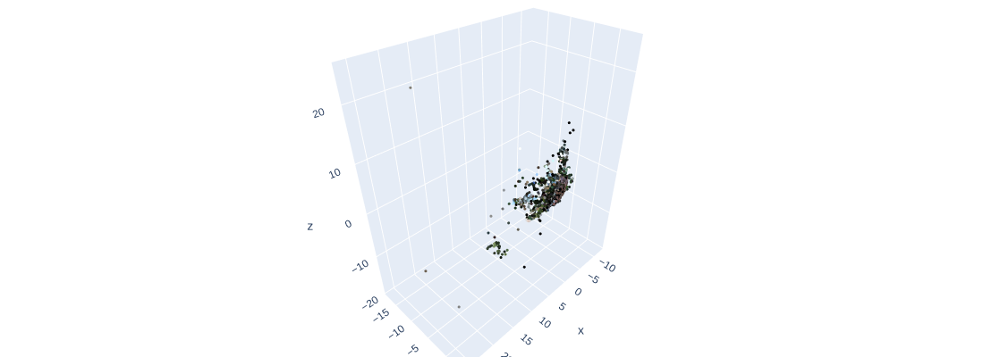

In [31]:
# Plot 3d generated cloud from COLMAP using open3d
# This data is the ORIGINAL cloud

pcd_o = o3d.geometry.PointCloud()
points = scene_pts_orig
pcd_o.points = o3d.utility.Vector3dVector(points)
pcd_o.colors = o3d.utility.Vector3dVector(rgb_data)

o3d.visualization.draw_plotly([pcd_o])


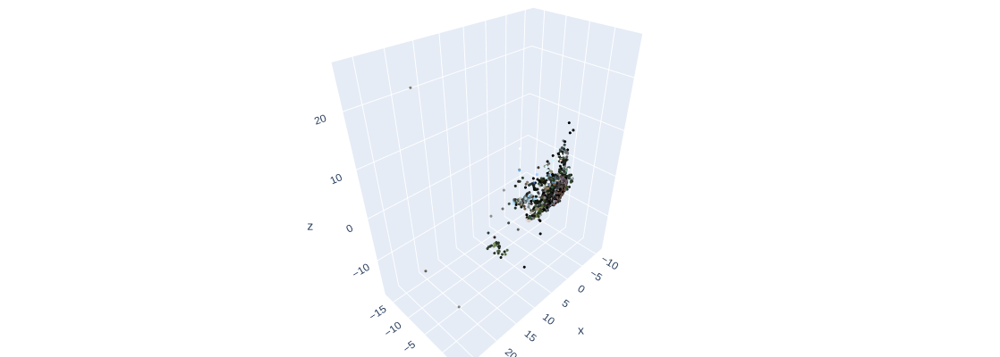

In [32]:
# Plot 3d generated cloud from COLMAP using open3d
# This data is after transformation 

pcd = o3d.geometry.PointCloud()
points = scene_pts
pcd.points = o3d.utility.Vector3dVector(points)
pcd.colors = o3d.utility.Vector3dVector(rgb_data) # For proper scaling in interactive window

o3d.visualization.draw_plotly([pcd])


In [33]:
# Visualization of coordinate frames from transformations

def draw_frame(fig, homo_trans, alpha = 1.):
    """fig = plotly figure object
       homo_trans = homogenous transformation matrix (4x4)"""

    x0 = homo_trans[0,3]
    y0 = homo_trans[1,3]
    z0 = homo_trans[2,3]
    x1, y1, z1 =  np.eye(3) @ homo_trans[:3,:3]
    x1 += homo_trans[0,-1]
    y1 += homo_trans[1,-1]
    z1 += homo_trans[2,-1]
    fig.add_trace(go.Scatter3d(x=[x0, x1[0]], y=[y0, y1[0]], z=[z0, z1[0]], mode='lines', line=dict(color='rgba(255, 0, 0, ' +str(alpha) + ')', width=5)))
    fig.add_trace(go.Scatter3d(x=[x0, x1[1]], y=[y0, y1[1]], z=[z0, z1[1]], mode='lines', line=dict(color='rgba(0, 255, 0, ' +str(alpha) + ')', width=5)))
    fig.add_trace(go.Scatter3d(x=[x0, x1[2]], y=[y0, y1[2]], z=[z0, z1[2]], mode='lines', line=dict(color='rgba(0, 0, 255, ' +str(alpha) + ')', width=5)))
    

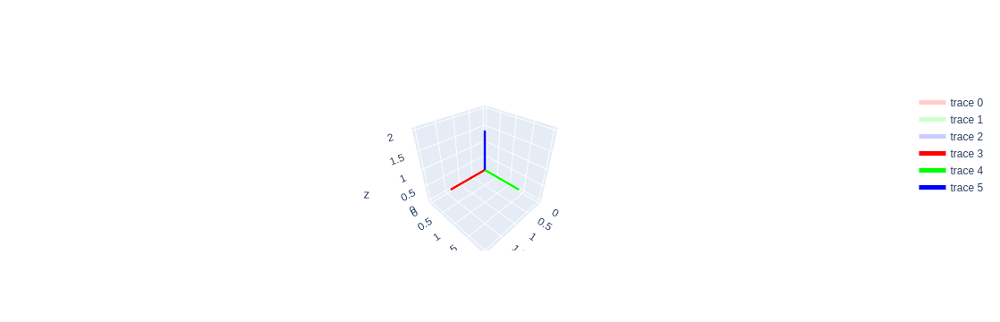

In [34]:
# Create a 3D figure
fig = go.Figure()
fig.update_layout(
    scene=dict(
        aspectmode='data'  # ensures all axes are scaled equally
    )
)

# For looping through consecutive transformations, see rotationMatrixDemo
draw_frame(fig, np.eye(4), alpha = .2)
draw_frame(fig, homo_trans, alpha = 1)

fig.show()

In [35]:
# Create an interactivate window visualization 

vis = o3d.visualization.Visualizer()
vis.create_window()
vis.add_geometry(pcd)

# view_control = vis.get_view_control()
render_option = vis.get_render_option()

render_option.background_color = [1, 1, 1] # [0.678, 0.847, 0.902] light blue 

vis.run()

vis.destroy_window()

# # Or, optionally 
# o3d.visualization.draw_geometries([pcd])

libGL: Can't open configuration file /etc/drirc: No such file or directory.
libGL: Can't open configuration file /home/daniel-choate/.drirc: No such file or directory.
using driver i915 for 75
libGL: Can't open configuration file /etc/drirc: No such file or directory.
libGL: Can't open configuration file /home/daniel-choate/.drirc: No such file or directory.
using driver i915 for 75
pci id for fd 75: 8086:a7a0, driver iris
MESA-LOADER: dlopen(/usr/lib/x86_64-linux-gnu/dri/iris_dri.so)
libGL: Can't open configuration file /etc/drirc: No such file or directory.
libGL: Can't open configuration file /home/daniel-choate/.drirc: No such file or directory.
libGL: Can't open configuration file /etc/drirc: No such file or directory.
libGL: Can't open configuration file /home/daniel-choate/.drirc: No such file or directory.
libGL: Can't open configuration file /etc/drirc: No such file or directory.
libGL: Can't open configuration file /home/daniel-choate/.drirc: No such file or directory.
Using 